<a href="https://colab.research.google.com/github/steliospyr/-/blob/main/wordclouds_creation_for_comparisons.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Δημιουργία wordclouds από κείμενα άρθρων που φέραμε από το monitor της Innews

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd

In [ ]:
df1= pd.read_csv('/content/drive/MyDrive/report (1).csv', encoding='iso-8859-7')

In [ ]:
df2= pd.read_csv('/content/drive/MyDrive/report (2).csv', encoding='iso-8859-7')

In [7]:
df3= pd.read_csv('/content/drive/MyDrive/report (3).csv', encoding='iso-8859-7')

In [8]:
df4= pd.read_csv('/content/drive/MyDrive/report (4).csv', encoding='iso-8859-7')

In [9]:
df5= pd.read_csv('/content/drive/MyDrive/report (5).csv', encoding='iso-8859-7')

In [10]:
import spacy

In [12]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

In [13]:
!python -m spacy download el_core_news_sm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.6/12.6 MB 44.3 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('el_core_news_sm')
⚠ Restart to reload dependencies
If you are in a Jupyter or Colab notebook, you may need to restart Python in
order to load all the package's dependencies. You can do this by selecting the
'Restart kernel' or 'Restart runtime' option.


In [14]:
nlp = spacy.load('el_core_news_sm')

In [15]:
df_combined = pd.concat([df1, df2, df3, df4, df5], ignore_index=True)


In [16]:
filo_text = df_combined['text'].str.cat(sep = ' ')
filo_text = " ".join(filo_text.split())
filo_text

'Το πρόβλημα που παρατηρείται στα χωριά Η ΜΑΣΤΙΓΑ ΣΤΑ ΧΩΡΙΑ ΤΟΥ ΡΕΘΥΜΝΟΥ: 7 στα 10 ατυχήματα προκαλούνται από οχήματα που τρέχουν άνω των 80 χλμ σε κατοικημένη περιοχή, που δεν έχει πεζοδρόμια Τα σαμαράκια απαγορεύονται αλλά κάποιοι τα έχουν κατασκευάσει μόνοι τους ΤΑ ΣΑΜΑΡΑΚΙΑ ΑΠΑΓΟΡΕΥΟΝΤΑΙ ΑΛΛΑ ΚΑΠΟΙΟΙ ΑΠΕΛΠΙΣΤΗΚΑΝ ΚΑΙ ΤΑ ΚΑΤΑΣΚΕΥΑΣΑΝ ΜΟΝΟΙ ΤΟΥΣ ΠΑΝΩ ΣΤΟ ΔΡΟΜΟ ΓΙΑ ΝΑ ΜΕΙΩΣΟΥΝ ΤΗΝ ΤΑΧΥΤΗΤΑ Ένα ενδειτκικό ατύχημα σε στενό δρόμο Ρεθυμνιώτικου χωριού έστειλε έναν τραυματία στην Εντατική, τα αυτοκίνητα περίμεναν σε ουρά 40 λεπτά και χρειάστηκε να επέμβει η Πυροσβεστική Υπηρεσία προκειμένου να απεγκλωβιστεί ο οδηγός Και το γεγονός αυτό άνοιξε την κουβέντα με τα αυτοκίνητα που τρέχουν σε κατοικημένη περιοχή άνω των 80 χλμ 7 στα 10 ατυχήματα στα χωριά του Ρεθύμνου προκαλούνται από αυτή την επαναλαμβανόμενη μάστιγα. Οχήματα \x96 ακόμα και βαρέως τύπου \x96 περνάνε με ταχύτητα άνω των 80 χλμ μέσα από κατοικημένη περιοχή Το συγκεκριμένο τροχαίο με εγκλωβισμό έγινε στην περιοχή της Πηγής του Δήμ

In [18]:

def create_wordcloud(text):
  wordcloud = WordCloud(
      stopwords = nlp.Defaults.stop_words,
      width = 2000,
      height = 1000,
      background_color = 'black'
  ).generate(filo_text)
  return wordcloud

In [17]:
def create_wordcloud_img(text):
  wordcloud = create_wordcloud(text)
  fig = plt.figure(
      figsize = (40, 30),
      facecolor = 'k',
      edgecolor = 'k')
  return plt.imshow(wordcloud)

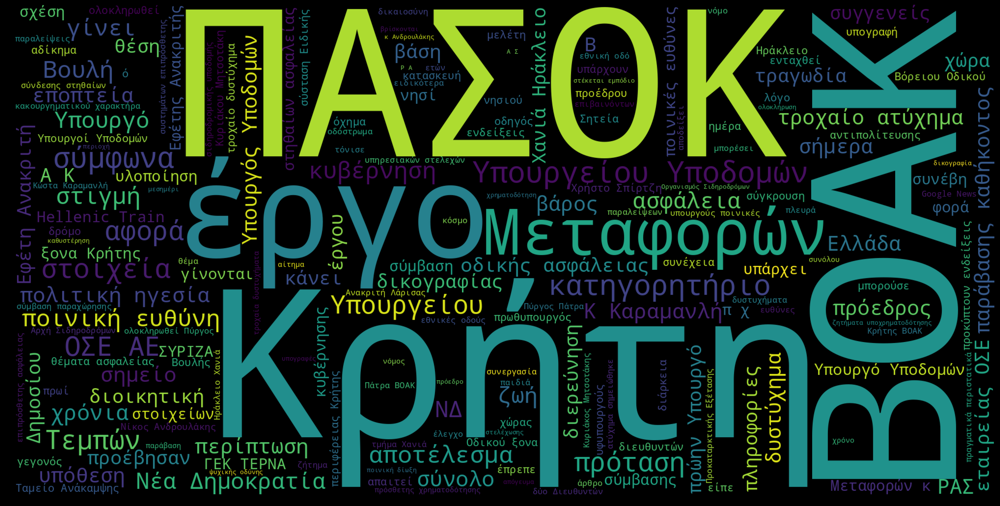

In [19]:
create_wordcloud_img(filo_text)

In [20]:
custom_stopwords = {"γίνει", "σύμφωνα", "νησί", "νησιού", "πρόταση", "σημείο", "μπορούσε", "συνέχεια"}

for word in custom_stopwords:
  if word not in nlp.Defaults.stop_words:
    nlp.Defaults.stop_words.add(word)
    lex_attr = nlp.vocab[word]
    lex_attr.is_stop = True

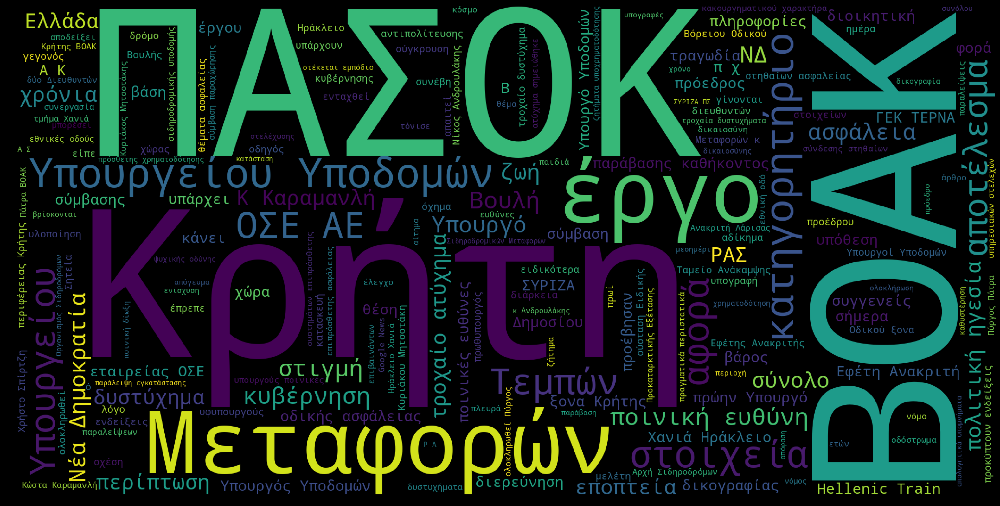

In [21]:
create_wordcloud_img(filo_text)